In [1]:
import matplotlib.pyplot as plt
import numpy as np
import ruptures as rpt
import welly
import pandas as pd
import cp_comparitor as cp_Comp
import change_point_tools as cp_Tools
import well_tools as wtool
import test_func as tst
import scipy.stats as stats

In [2]:
path = 'C:\\Users\\ada55080\\git\different_bayes\\volve_well_data\\'

In [8]:
#setting global variables for the ruptures PELT parameters pen and min_size 
 
f1A = welly.Well.from_las(path + '15_9-F-1A\\15_9-F-1A.las')
f1B = welly.Well.from_las(path + '15_9-F-1B\\15_9-F-1B.las')
f1C = welly.Well.from_las(path + '15_9-F-1C\\15_9-F-1C.las')
f11A = welly.Well.from_las(path + '15_9-F-11A\\15_9-F-11A.las')
f11B = welly.Well.from_las(path + '15_9-F-11B\\15_9-F11B.las')

Defining some functions that are not yet implemented in the tools packages above 
(probably because they are not yet well documented :( 

In [66]:
#wtool = well_tools.well_tools()

def spearman_offset(comparitee_vector, comparitor_vector, **kwargs):
    _window = kwargs.get('window')
    _match_param = kwargs.get('param')
    stat = []
    pvalue = []
    tee = comparitee_vector
    tor = comparitor_vector

    if len(tor)<len(tee[:_window]):
        print("Comparitor is shorter than comparitee, this won't do, try a shorter sequence") 
    else:
        for i in range(len(tor)-len(tee)):
            SigRes = (stats.spearmanr(tor[i:i+_window],tee[:_window]))
            stat.append(SigRes.statistic)
            pvalue.append(SigRes.pvalue)
        statAray = np.array(stat)
        statAray = np.nan_to_num(statAray, nan=0.0)
        
        pvalueAray = np.array(pvalue)
        pvalueAray = np.nan_to_num(pvalueAray, nan=1)
        print('statArgmax= ' + str(statAray.argmax()) + ' val ' + str(statAray[statAray.argmax()]))
        print('pvalArgmin= ' + str(pvalueAray.argmin()) + ' val ' + str(pvalueAray[pvalueAray.argmin()]))
        #print
    if _match_param == 'pval':
        return pvalueAray.argmin()
    elif _match_param == 'sval':
        return statAray.argmax()
    else:
        return pvalueAray.argmin()

    

In [27]:
from itertools import product

def generate_progressive_combinations(*number_sets):
    combinations = list(product(*number_sets))
    progressive_combinations = []
    for combination in combinations:
        is_progressive = True
        for i in range(len(combination) - 1):
            if combination[i+1] <= combination[i]:
                is_progressive = False
                break
        if is_progressive:
            progressive_combinations.append(combination)

    return progressive_combinations

# Example usage:
set1 = [1, 2, 3]
set2 = [2, 3, 4]

The following dictionaries are #global# place holder variables.

In [10]:


#Rolling average parameters

#window = 30
#periods = 3

#setting global variables for the ruptures PELT parameters pen and min_size 
RHOB_glob_pen = 0.5
RHOB_glob_min = 10

NPHI_glob_pen = 0.1
NPHI_glob_min = 10

GR_glob_pen = 1300
GR_glob_min = 10


#string label varables
dataGR = "GR"
dataRHOB = "RHOB"
dataNPHI = "NPHI"

#Well names lists for automation
_wellnames = ['df_f1A', 'df_f1B', 'df_f1C', 'df_f11A', 'df_f11B']
_wells = [f1A, f1B, f1C, f11A, f11B]
_log_list = {'NPHI','RHOB','GR','DT','PEF'}

#Dictionaries for log extents

_logname_extent_min = {'f1A' : 2620, 'f1B' : 3100 , 'f1C': 3100 , 'f11A' : 2600 , 'f11B': 3200 }
_logname_extent_max = {'f1A' : 3600, 'f1B' : 3400 , 'f1C': 4100 , 'f11A' : 3700 , 'f11B': 4550 }
_log_extent_min = {0 : 2620, 1 : 3100 , 2: 3100 , 3 : 2600 , 4: 3200 }
_log_extent_max = {0: 3600, 1 : 3400 , 2: 4100 , 3 : 3700 , 4: 4550 }


####Loading Volve Well logs... These logs do not have any spacial awareness so everthing is relative to the Measured Depth
in the borehole future implementations will need some 3D awareness to be convincing, as these particular wells are 
controlled for depth and are clearly in the same basin they can work for this illustration

In [11]:
# Writing well log values to dataframe, index is MD(measured depth)
df_f1A = _wells[0].df(_log_list)
df_f1B = _wells[1].df(_log_list)
df_f1C = _wells[2].df(_log_list)
df_f11A = _wells[3].df(_log_list)
df_f11B = _wells[4].df(_log_list)

data_f1A = wtool.compute_all_rolling_avg(df_f1A, window=30, periods=3)
data_f1B = wtool.compute_all_rolling_avg(df_f1B, window=30, periods=3)
data_f1C = wtool.compute_all_rolling_avg(df_f1C, window=30, periods=3)
data_f11A = wtool.compute_all_rolling_avg(df_f11A, window=30, periods=3)
data_f11B = wtool.compute_all_rolling_avg(df_f11B, window=30, periods=3)


# #NaN handling (simple dataset average replaces all NaN's)
# string = 'rollNPHI'
# datalabel = 'NPHI'
# df= pd.DataFrame()
# df[string] = df_f1A[datalabel].rolling(30, min_periods=3).mean()
# col= pd.DataFrame(df_f11A).columns.unique()
# #col = df_f1A.columns.unique()
# for i in col:
#     print(i)
# df[3400:3410]
# datalabel = 'NPHI'
# #dataroll = wtool.df_rolling_avg(df_f1A, 'NPHI', periods=30)

c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\curve.py:470: FutureWarning: Index.is_numeric is deprecated. Use pandas.api.types.is_any_real_numeric_dtype instead
  if self.df.index.is_numeric() and not self.df.index.empty:
c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\curve.py:470: FutureWarning: Index.is_numeric is deprecated. Use pandas.api.types.is_any_real_numeric_dtype instead
  if self.df.index.is_numeric() and not self.df.index.empty:
c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\curve.py:470: FutureWarning: Index.is_numeric is deprecated. Use pandas.api.types.is_any_real_numeric_dtype instead
  if self.df.index.is_numeric() and not self.df.index.empty:
c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\curve.py:470: FutureWarning: Index.is_numeric is deprecated. Use pandas.api.types.is_any_real_numeric_dtype instead
  if self.df.index.is_numeric() and not self.df.index.empty:
c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\cu

In [25]:
''' Formatting cell, to check that everthing is getting stacked well'''
#matrix = np.column_stack((data_f1A[3000:3001].index, data_f1A['GR'][3000:3001]))
#matrix
#ara = data_f1A[[index,'GR']][3000:3001].to_numpy()
#dtest = data_f11A['DEPTH','GR'][3000:3010].to_numpy()
#aray = dtest.to_xarray()
#dtest
#np.shape(ara)

##Finding breakpoints and trends for Volve input, ONLY UNIVARIATE LOGS for this example:

Using PELT search algorythm in this example... for simplicity. 

It is an offline method that produces a discrete breakpoint. 

Trend values are the mean for the data sections between breakpoints.

Future implementations will include a variety of search functions, with probabilities and stocastics

In [31]:
_log_choice = 'Roll_Avg_PEF'
pennumPEF = 50
minsizPEF = 20


f1A_PEFmu, f1A_PEFbp = cp_Comp.piecewise_linearRegress(data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_numpy(), pen=pennumPEF, min_size=minsizPEF)
f1B_PEFmu, f1B_PEFbp = cp_Comp.piecewise_linearRegress(data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy(), pen=pennumPEF, min_size=minsizPEF)
f1C_PEFmu, f1C_PEFbp = cp_Comp.piecewise_linearRegress(data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]-70].to_numpy(), pen=pennumPEF, min_size=minsizPEF)
f11A_PEFmu, f11A_PEFbp = cp_Comp.piecewise_linearRegress(data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_numpy(), pen=pennumPEF, min_size=minsizPEF)
f11B_PEFmu, f11B_PEFbp = cp_Comp.piecewise_linearRegress(data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]].to_numpy(), pen=pennumPEF, min_size=minsizPEF)

13 [   0. 1520. 3725. 6085. 6685. 7150. 7490. 7790. 7975. 8115. 8160. 8465.
 9800.]
[0.         5.09759695 7.86613315 7.5109809  7.07503962 6.49939313
 7.60775463 6.65670544 7.58152411 6.71773138 9.06036748 5.46160863
 5.94529523]
9 [   0.  255. 1045. 1185. 1415. 1465. 2045. 2130. 3000.]
[0.         7.60595876 6.94353425 6.0008024  6.85414878 8.7788506
 5.60680571 7.09069659 6.13486678]
19 [   0.  570.  860. 1155. 1315. 1560. 1805. 2430. 3205. 3725. 4310. 5150.
 5390. 6155. 6555. 6605. 7295. 9030. 9300.]
[0.         7.6109513  6.92453722 7.9976373  7.08038556 6.08222888
 5.31632023 6.62420697 5.6380471  6.34283649 5.29302623 5.84520062
 4.88863006 5.47229932 4.94593156 8.14971253 5.00451143 5.51916744
 6.8075767 ]
18 [    0.   255.  1065.  1255.  1435.  1540.  1950.  5770.  6965.  8615.
  9060.  9260.  9575.  9610.  9905.  9960. 10655. 11000.]
[0.         6.30956837 5.32980255 6.15062298 5.03873759 6.62674222
 5.42472805 8.34959787 8.05978159 7.7276963  7.14238921 8.0998325
 7.13970794

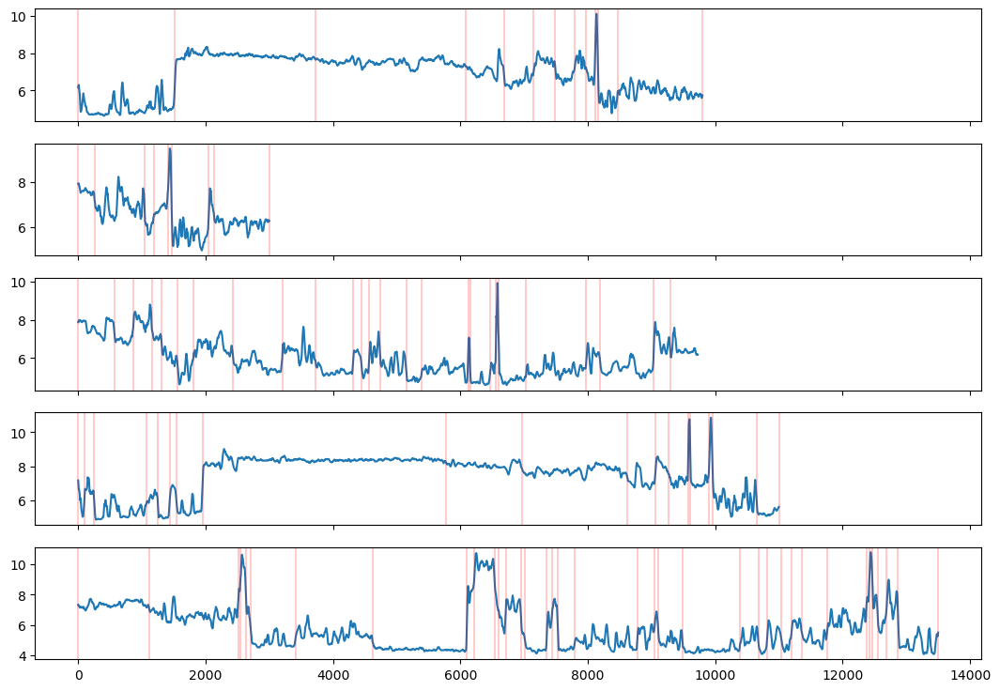

In [30]:
fig, ax = plt.subplots(5, figsize=[13, 9], sharex=True)

_log_choice = 'Roll_Avg_PEF'
len(data_f1A[_log_extent_min[0]:_log_extent_max[0]])
ax[0].plot(np.arange(len(data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]])), data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]])
for i in f1A_PEFbp:
    ax[0].axvline(i, c='r', alpha=0.2)
ax[1].plot(np.arange(len(data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]])), data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]])
for i in f1B_PEFbp:
    ax[1].axvline(i, c='r', alpha=0.2)
ax[2].plot(np.arange(len(data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]])), data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]])
for i in f1C_PEFbp:
    ax[2].axvline(i, c='r', alpha=0.2)
ax[3].plot(np.arange(len(data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]])), data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]])
for i in f11A_PEFbp:
    ax[3].axvline(i, c='r', alpha=0.2)
ax[4].plot(np.arange(len(data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]])), data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]])
for i in f11B_PEFbp:
    ax[4].axvline(i, c='r', alpha=0.2)

In [15]:
_log_choice = 'Roll_Avg_NPHI'
pennum = 0.3
minsiz = 10

#NPHI

f1A_NPHImu, f1A_NPHIbp = cp_Comp.piecewise_linearRegress(data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_numpy(), pen=pennum, min_size=minsiz)
f1B_NPHImu, f1B_NPHIbp = cp_Comp.piecewise_linearRegress(data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy(), pen=pennum, min_size=minsiz)
f1C_NPHImu, f1C_NPHIbp = cp_Comp.piecewise_linearRegress(data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]-70].to_numpy(), pen=pennum, min_size=minsiz)
f11A_NPHImu, f11A_NPHIbp = cp_Comp.piecewise_linearRegress(data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_numpy(), pen=pennum, min_size=minsiz)
f11B_NPHImu, f11B_NPHIbp = cp_Comp.piecewise_linearRegress(data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]].to_numpy(), pen=pennum, min_size=minsiz)

18 [   0.  520.  795. 1540. 1680. 2300. 3685. 4385. 5155. 5755. 7150. 7385.
 7790. 7970. 8160. 8655. 9265. 9800.]
[0.         0.24014083 0.29967659 0.25021347 0.1932794  0.13397296
 0.07080634 0.11843025 0.07642712 0.11867274 0.14673052 0.20586786
 0.42945248 0.48026967 0.33388784 0.19562459 0.12217989 0.16283398]
9 [   0.  605.  695. 1015. 1220. 1470. 2050. 2270. 3000.]
[0.         0.15064523 0.21558315 0.44033746 0.32409928 0.25547812
 0.17657756 0.10295224 0.15990907]
15 [   0. 1075. 1140. 1295. 2635. 2875. 3510. 4315. 4690. 6065. 6660. 7485.
 7985. 9060. 9300.]
[0.         0.16345536 0.46053523 0.31324649 0.20736322 0.15039522
 0.23138073 0.18354676 0.14577385 0.20290871 0.13908756 0.17410387
 0.20735547 0.16195856 0.2755936 ]
17 [    0.   260.   405.  1765.  1970.  2195.  3735.  4235.  5195.  6340.
  8305.  9045.  9270.  9595.  9710.  9960. 11000.]
[0.         0.33602205 0.22084644 0.28842039 0.23825707 0.15724844
 0.08629788 0.13209347 0.07452684 0.12435459 0.09132324 0.1550859
 

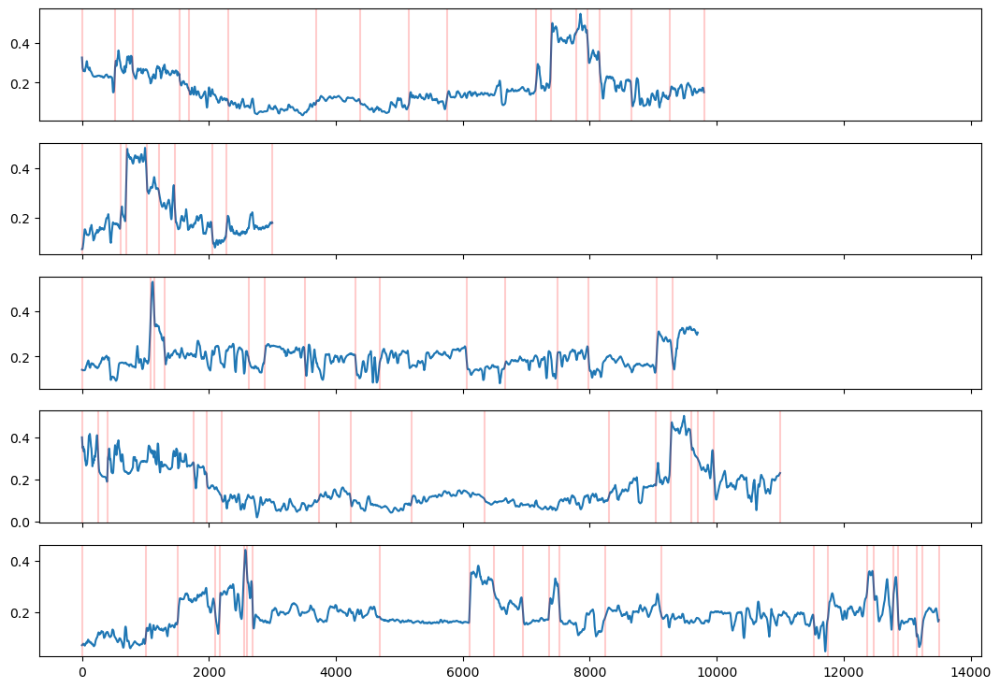

In [32]:
fig, ax = plt.subplots(5, figsize=[13, 9], sharex=True)

_log_choice = 'Roll_Avg_NPHI'
len(data_f1A[_log_extent_min[0]:_log_extent_max[0]])
ax[0].plot(np.arange(len(data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]])), data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]])
for i in f1A_NPHIbp:
    ax[0].axvline(i, c='r', alpha=0.2)
ax[1].plot(np.arange(len(data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]])), data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]])
for i in f1B_NPHIbp:
    ax[1].axvline(i, c='r', alpha=0.2)
ax[2].plot(np.arange(len(data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]])), data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]])
for i in f1C_NPHIbp:
    ax[2].axvline(i, c='r', alpha=0.2)
ax[3].plot(np.arange(len(data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]])), data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]])
for i in f11A_NPHIbp:
    ax[3].axvline(i, c='r', alpha=0.2)
ax[4].plot(np.arange(len(data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]])), data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]])
for i in f11B_NPHIbp:
    ax[4].axvline(i, c='r', alpha=0.2)



In [38]:
_log_choice = 'Roll_Avg_GR'
pennum = 30000
minsiz = 20


f1A_GRmu, f1A_GRbp = cp_Comp.piecewise_linearRegress(data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_numpy(), pen=pennum, min_size=minsiz)
f1B_GRmu, f1B_GRbp = cp_Comp.piecewise_linearRegress(data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy(), pen=pennum, min_size=minsiz)
f1C_GRmu, f1C_GRbp = cp_Comp.piecewise_linearRegress(data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]].to_numpy(), pen=pennum, min_size=minsiz)
f11A_GRmu, f11A_GRbp = cp_Comp.piecewise_linearRegress(data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_numpy(), pen=pennum, min_size=minsiz)
f11B_GRmu, f11B_GRbp = cp_Comp.piecewise_linearRegress(data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]].to_numpy(), pen=pennum, min_size=minsiz)

17 [   0. 1525. 4860. 5750. 6690. 7385. 7405. 7480. 7535. 7750. 7820. 7900.
 7945. 7975. 7995. 8105. 9800.]
[  0.          37.98706503   8.57514576  29.01757565  42.34702568
  59.35316335 152.84521597 273.46985435 198.74781189 235.60999646
 313.96294059 363.3100445  298.3490337  360.33069438 198.99786685
 144.71266072  45.20807284]
9 [   0.  485.  690.  710. 1030. 1225. 1390. 2100. 3000.]
[  0.          40.01435658  58.33567297 145.74052854 232.68399881
 137.71873418 103.11501435  34.25855825  49.30993912]
24 [   0.  445.  565. 1060. 1080. 1120. 1150. 1170. 1230. 1310. 1790. 2405.
 2885. 3190. 3810. 4890. 5150. 5410. 6060. 6675. 8020. 9055. 9360. 9939.]
[  0.          44.329439    23.06433583  53.80349445 187.64743832
 286.52569124 458.68232781 204.53049742 130.73851686  92.87442089
  17.22414334  62.92141303  47.44002309  32.39122697  52.02827561
  33.23200889  46.91388176  14.33522845  43.80801356  11.39871215
  38.36302676  21.78749474  66.26230894 112.8370428 ]
18 [    0.   255.  1

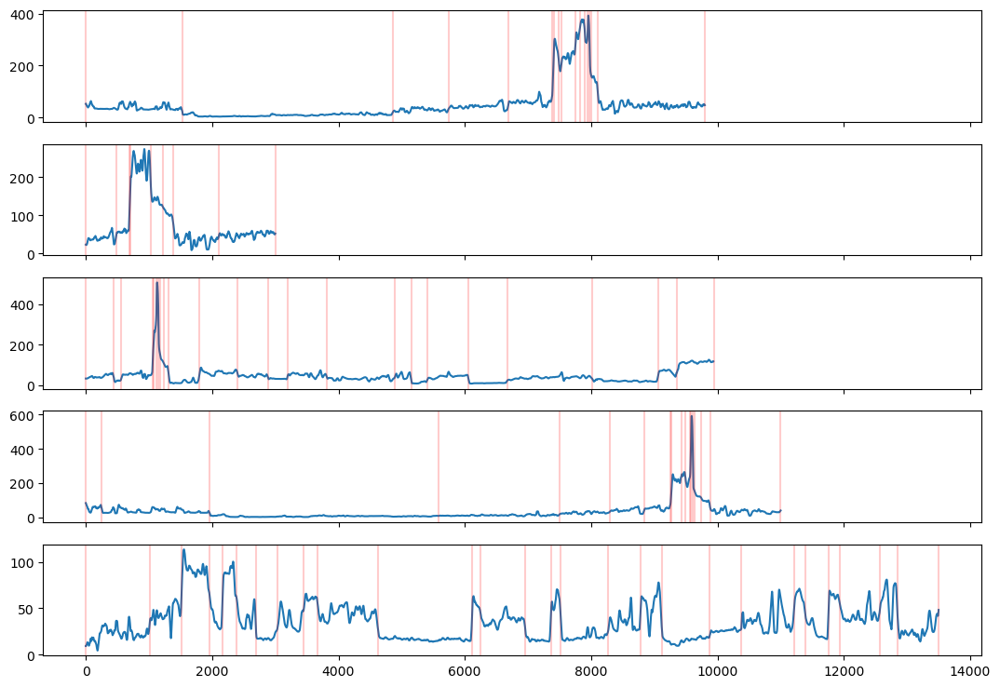

In [39]:
fig, ax = plt.subplots(5, figsize=[13, 9], sharex=True)

_log_choice = 'Roll_Avg_GR'
len(data_f1A[_log_extent_min[0]:_log_extent_max[0]])
ax[0].plot(np.arange(len(data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]])), data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]])
for i in f1A_GRbp:
    ax[0].axvline(i, c='r', alpha=0.2)
ax[1].plot(np.arange(len(data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]])), data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]])
for i in f1B_GRbp:
    ax[1].axvline(i, c='r', alpha=0.2)
ax[2].plot(np.arange(len(data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]])), data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]])
for i in f1C_GRbp:
    ax[2].axvline(i, c='r', alpha=0.2)
ax[3].plot(np.arange(len(data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]])), data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]])
for i in f11A_GRbp:
    
    ax[3].axvline(i, c='r', alpha=0.2)
ax[4].plot(np.arange(len(data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]])), data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]])
for i in f11B_GRbp:
    ax[4].axvline(i, c='r', alpha=0.2)

#### Looking at segments bound by changepoints nad finding the trends. (Arithmetic average in this example)

In [40]:
_log_choice = 'Roll_Avg_RHOB'
pennumRHOB = 1
minsizRHOB = 10


f1A_RHOBmu, f1A_RHOBbp = cp_Comp.piecewise_linearRegress(data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_numpy(), pen=pennumRHOB, min_size=minsizRHOB)
f1B_RHOBmu, f1B_RHOBbp = cp_Comp.piecewise_linearRegress(data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy(), pen=pennumRHOB, min_size=minsizRHOB)
f1C_RHOBmu, f1C_RHOBbp = cp_Comp.piecewise_linearRegress(data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]-70].to_numpy(), pen=pennumRHOB, min_size=minsizRHOB)
f11A_RHOBmu, f11A_RHOBbp = cp_Comp.piecewise_linearRegress(data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_numpy(), pen=pennumRHOB, min_size=minsizRHOB)
f11B_RHOBmu, f11B_RHOBbp = cp_Comp.piecewise_linearRegress(data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]].to_numpy(), pen=pennumRHOB, min_size=minsizRHOB)

12 [   0. 1520. 2125. 2710. 3585. 7395. 7960. 8115. 8160. 8660. 9245. 9800.]
[0.         2.24849228 2.4650963  2.54354802 2.61899464 2.56183721
 2.26207781 2.47854974 2.74945985 2.39229037 2.54912252 2.45891316]
8 [   0.  700. 1010. 1415. 1465. 2050. 2275. 3000.]
[0.         2.54584524 2.25266333 2.49408466 2.73611787 2.31364324
 2.59207604 2.46926358]
24 [   0. 1090. 1125. 1325. 1795. 2430. 2655. 2880. 3190. 3520. 3555. 3820.
 4315. 4420. 4570. 4690. 4965. 5020. 7030. 7980. 8200. 8525. 9040. 9300.]
[0.         2.56096265 2.29864057 2.50383368 2.28482614 2.48669448
 2.33774258 2.52728076 2.22590312 2.41273661 2.66842533 2.47702389
 2.22433081 2.52779048 2.29292093 2.48682264 2.28818422 2.47558964
 2.25404964 2.30957565 2.49835798 2.21805883 2.35299397 2.52901388]
17 [    0.   575.  1440.  1540.  1945.  2135.  4360.  5200.  6340.  9280.
  9575.  9910.  9955. 10025. 10610. 10650. 11000.]
[0.         2.27777658 2.21896266 2.369172   2.1946884  2.46292228
 2.55774858 2.60239944 2.5209436  

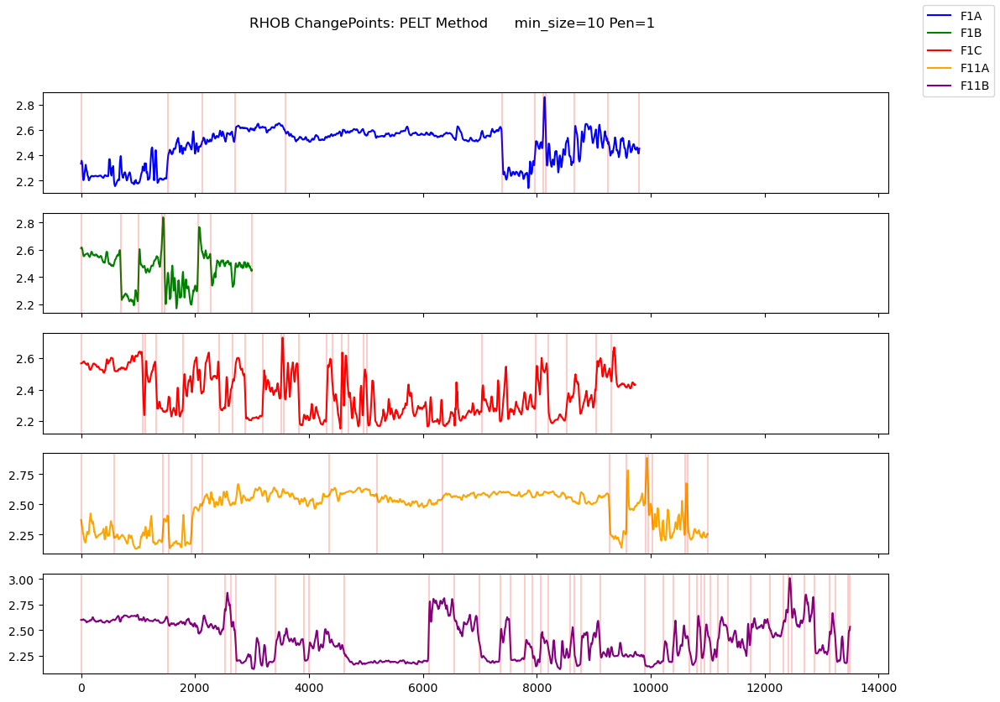

In [53]:
'''Graph for bulk density of the 5 test logs''' 

fig, ax = plt.subplots(5, figsize=[13, 9], sharex=True)

#plt.title('RHOB ChangePoints: PELT Method min_size= '+ str(minsizRHOB)+' Pen= ' + str(pennumRHOB) )
_log_choice = 'Roll_Avg_RHOB'
len(data_f1A[_log_extent_min[0]:_log_extent_max[0]])
fig.suptitle('RHOB ChangePoints: PELT Method      min_size='+ str(minsizRHOB)+' Pen=' + str(pennumRHOB) )
ax[0].plot(np.arange(len(data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]])), data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]], label='F1A', c='blue')
for i in f1A_RHOBbp:
    ax[0].axvline(i, c='r', alpha=0.2)
ax[1].plot(np.arange(len(data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]])), data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]], label='F1B', c ='green')
for i in f1B_RHOBbp:
    ax[1].axvline(i, c='r', alpha=0.2)
ax[2].plot(np.arange(len(data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]])), data_f1C[_log_choice][_log_extent_min[2]:_log_extent_max[2]], label='F1C', c='red')
for i in f1C_RHOBbp:
    ax[2].axvline(i, c='r', alpha=0.2)
ax[3].plot(np.arange(len(data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]])), data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]], label='F11A', c='orange')
for i in f11A_RHOBbp:
    ax[3].axvline(i, c='r', alpha=0.2)
ax[4].plot(np.arange(len(data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]])), data_f11B[_log_choice][_log_extent_min[4]:_log_extent_max[4]], label='F11B', c='purple')
for i in f11B_RHOBbp:
    ax[4].axvline(i, c='r', alpha=0.2)

fig.legend()


##### Spearman Correlation method for well log correlation, getting mixed results... 

good matching with bulk density but porosity is not as robust. Correlation must be done with matching dataset length,
this is a limition for this method as lateral continuity cannot be assumed.

In [23]:
f1B_spear = data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy()
f11A_spear = data_f11A[_log_choice][_log_extent_min[4]:_log_extent_max[4]].to_numpy()

#f1B_f11A_offset = spearman_offset(f1B_spear, f11A_spear, window= 700)
#f1B_RHOBbp, f1A_RHOBbp

statArgmax= 9264 val 0.8626180589046183
pvalArgmin= 9264 val 3.2379749826795956e-213
statArgmax= 6159 val 0.5697389537193023
pvalArgmin= 5363 val 0.0


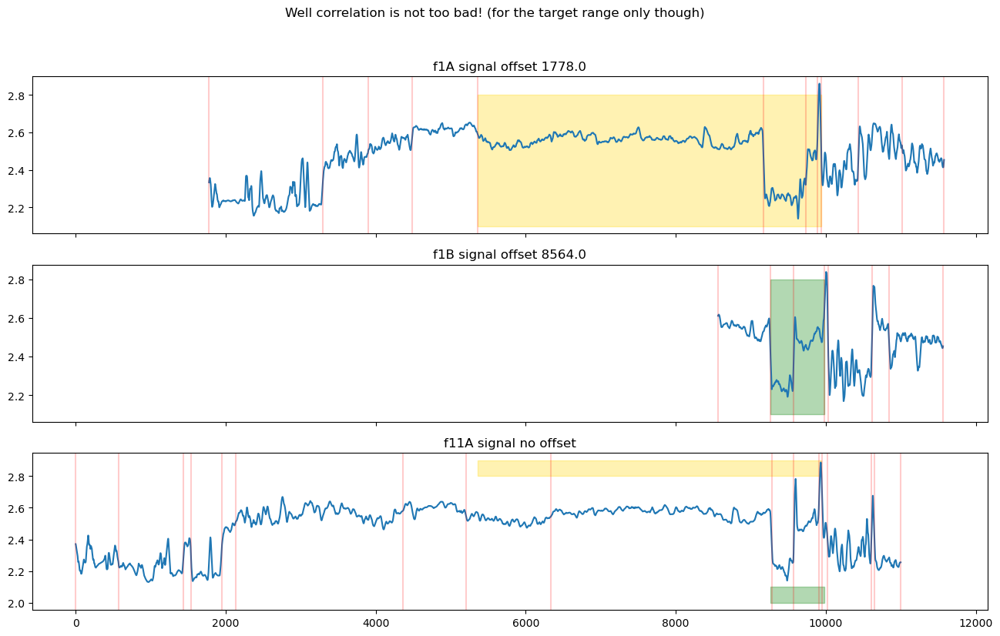

In [67]:
_log_choice = 'Roll_Avg_RHOB'
f1B_spear = data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy()
f11A_spear = data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_numpy()
f1A_spear = data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_numpy()

f1B_11A_params = {'min':1, 'max':3} 
f1A_11A_params = {'min':4, 'max':8} 



f1B_f11A_offset = spearman_offset(f1B_spear[int(f1B_RHOBbp[f1B_11A_params['min']]):int(f1B_RHOBbp[f1B_11A_params['max']])], f11A_spear, 
                                    window=len(f1B_spear[int(f1B_RHOBbp[f1B_11A_params['min']]):int(f1B_RHOBbp[f1B_11A_params['max']])]))
f1A_f11A_offset = spearman_offset(f1A_spear[int(f1A_RHOBbp[f1A_11A_params['min']]):int(f1A_RHOBbp[f1A_11A_params['max']])], f11A_spear, 
                                    window=len(f1A_spear[int(f1A_RHOBbp[f1A_11A_params['min']]):int(f1A_RHOBbp[f1A_11A_params['max']])]))

fig, ax = plt.subplots(3, figsize=[16, 9], sharex=True)
fig.suptitle('Well correlation is not too bad! (for the target range only though)')
xoffset_f11A = f1A_f11A_offset#-f1A_RHOBbp[f1A_11A_params['min']]
xoffset_f1B = f1B_f11A_offset

rangef11A = xoffset_f11A + f1A_RHOBbp[f1A_11A_params['max']] - f1A_RHOBbp[f1A_11A_params['min']]
rangef1B = xoffset_f1B + f1B_RHOBbp[f1B_11A_params['max']] - f1B_RHOBbp[f1B_11A_params['min']]

ax[0].plot(np.arange(len(f1A_spear))+f1A_f11A_offset-f1A_RHOBbp[f1A_11A_params['min']], f1A_spear)
ax[0].set_title('f1A signal offset '+str(f1A_f11A_offset-f1A_RHOBbp[f1A_11A_params['min']]))
for i in f1A_RHOBbp:
    ax[0].axvline(i+f1A_f11A_offset-f1A_RHOBbp[f1A_11A_params['min']], c='r', alpha=0.2)
A1xx = np.linspace(xoffset_f11A, rangef11A ,100)

ax[0].fill_between(A1xx, 2.8 , 2.1, alpha=0.3, color='gold')
#plt.fill_between(x, slope0 * x + intercept0, 0, facecolor='gold', alpha=0.4, edgecolor='r', hatch='xx')

B1xx = np.linspace(xoffset_f1B, rangef1B , 100)
ax[1].fill_between(B1xx, 2.8 , 2.1, alpha=0.3, color='green')
ax[1].plot(np.arange(len(f1B_spear))+f1B_f11A_offset-f1B_RHOBbp[f1B_11A_params['min']], f1B_spear)
ax[1].set_title('f1B signal offset '+ str(f1B_f11A_offset-f1B_RHOBbp[f1B_11A_params['min']]))
for i in f1B_RHOBbp:
    ax[1].axvline(i+f1B_f11A_offset-f1B_RHOBbp[f1B_11A_params['min']], c='r', alpha=0.2)

ax[2].fill_between(A1xx, 2.9 , 2.8, alpha=0.3, color='gold')
ax[2].fill_between(B1xx, 2.0 , 2.1, alpha=0.3, color='green')
ax[2].plot(np.arange(len(f11A_spear)), f11A_spear)
ax[2].set_title('f11A signal no offset')
for i in f11A_RHOBbp:
    ax[2].axvline(i, c='r', alpha=0.2)

statArgmax= 9177 val 0.8719083228391188
pvalArgmin= 9177 val 7.572645184429486e-270
statArgmax= 7116 val 0.774106628017517
pvalArgmin= 7116 val 7.414441493826371e-118


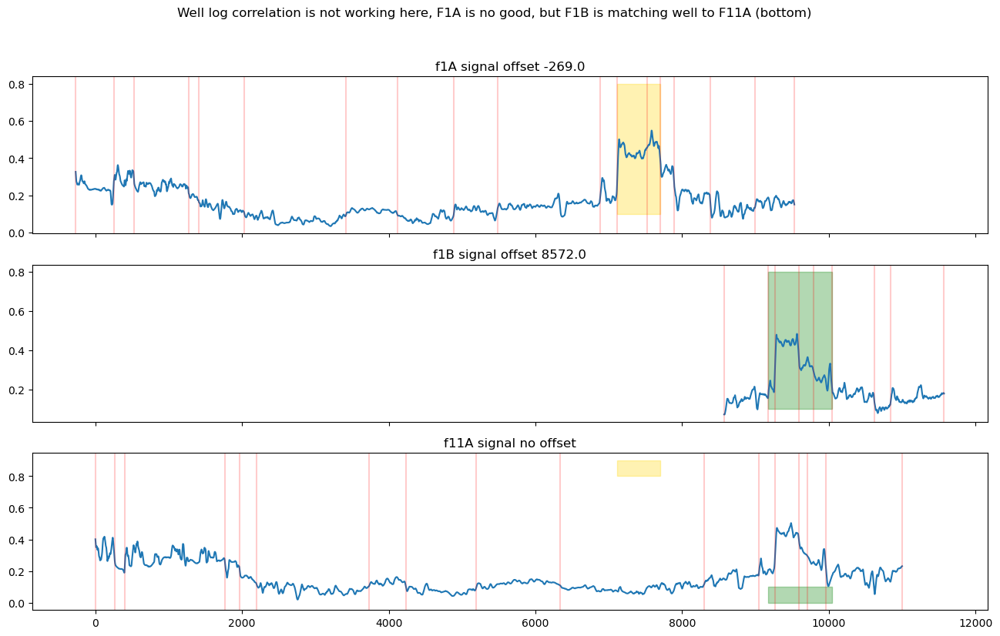

In [69]:
_log_choice = 'Roll_Avg_NPHI'
f1B_spear = data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy()
f11A_spear = data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_numpy()
f1A_spear = data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_numpy()

f1B_11A_params = {'min':1, 'max':5} 
f1A_11A_params = {'min':11, 'max':13} 



f1B_f11A_offset = spearman_offset(f1B_spear[int(f1B_NPHIbp[f1B_11A_params['min']]):int(f1B_NPHIbp[f1B_11A_params['max']])], f11A_spear, 
                                    window=len(f1B_spear[int(f1B_NPHIbp[f1B_11A_params['min']]):int(f1B_NPHIbp[f1B_11A_params['max']])]))
f1A_f11A_offset = spearman_offset(f1A_spear[int(f1A_NPHIbp[f1A_11A_params['min']]):int(f1A_NPHIbp[f1A_11A_params['max']])], f11A_spear, 
                                    window=len(f1A_spear[int(f1A_NPHIbp[f1A_11A_params['min']]):int(f1A_NPHIbp[f1A_11A_params['max']])]), param='sval')

fig, ax = plt.subplots(3, figsize=[16, 9], sharex=True)
fig.suptitle('Well log correlation is not working here, F1A is no good, but F1B is matching well to F11A (bottom)')
xoffset_f11A = f1A_f11A_offset#-f1A_NPHIbp[f1A_11A_params['min']]
xoffset_f1B = f1B_f11A_offset

#rangef11A = yoffset_f11A + f1A_NPHIbp[f1A_11A_params['max']] - f1A_NPHIbp[f1A_11A_params['min']]
#rangef1B = xoffset_f1B + f1B_NPHIbp[f1B_11A_params['max']] - f1B_NPHIbp[f1B_11A_params['min']]

rangef11A = xoffset_f11A + f1A_NPHIbp[f1A_11A_params['max']] - f1A_NPHIbp[f1A_11A_params['min']]
rangef1B = xoffset_f1B + f1B_NPHIbp[f1B_11A_params['max']] - f1B_NPHIbp[f1B_11A_params['min']]

ax[0].plot(np.arange(len(f1A_spear))+f1A_f11A_offset-f1A_NPHIbp[f1A_11A_params['min']], f1A_spear)
ax[0].set_title('f1A signal offset '+str(f1A_f11A_offset-f1A_NPHIbp[f1A_11A_params['min']]))
for i in f1A_NPHIbp:
    ax[0].axvline(i+f1A_f11A_offset-f1A_NPHIbp[f1A_11A_params['min']], c='r', alpha=0.2)
A1xx = np.linspace(xoffset_f11A, rangef11A ,100)

ax[0].fill_between(A1xx, .8 , .1, alpha=0.3, color='gold')
#plt.fill_between(x, slope0 * x + intercept0, 0, facecolor='gold', alpha=0.4, edgecolor='r', hatch='xx')

B1xx = np.linspace(xoffset_f1B, rangef1B , 100)
ax[1].fill_between(B1xx, .8 , .1, alpha=0.3, color='green')
ax[1].plot(np.arange(len(f1B_spear))+f1B_f11A_offset-f1B_NPHIbp[f1B_11A_params['min']], f1B_spear)
ax[1].set_title('f1B signal offset '+ str(f1B_f11A_offset-f1B_NPHIbp[f1B_11A_params['min']]))
for i in f1B_NPHIbp:
    ax[1].axvline(i+f1B_f11A_offset-f1B_NPHIbp[f1B_11A_params['min']], c='r', alpha=0.2)

ax[2].fill_between(A1xx, .9 , .8, alpha=0.3, color='gold')
ax[2].fill_between(B1xx, .0 , .1, alpha=0.3, color='green')
ax[2].plot(np.arange(len(f11A_spear)), f11A_spear)
ax[2].set_title('f11A signal no offset')
for i in f11A_NPHIbp:
    ax[2].axvline(i, c='r', alpha=0.2)

#### The following section are other methods that I am working with for automated correlation

1700771.96897444


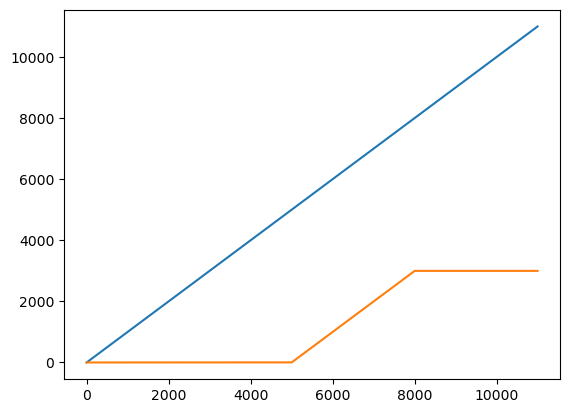

In [310]:

'''This cell is attempting some correlation with Dynamic Time Warping... I'm not getting perfect results with it but I think it
has good potenial.  

This very recent publication thinks so too:
Automated multi-well stratigraphic correlation and model building using relative geologic time
Zoltán Sylvester
First published: 16 June 2023 https://doi.org/10.1111/bre.12787
'''

#for i in f1B_RHOBbp:
import numpy as np
from scipy.spatial.distance import euclidean
from fastdtw import fastdtw
_log_choice = 'Roll_Avg_RHOB'
#f1B_DTW = data_f1B['DEPTH',_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy()
#f11A_DTW = data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_xarray()
#f1A_DTW = data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_xarray()
#x = np.array([[1,1], [2,2], [3,3], [4,4], [5,5]])
#y = np.array([[2,2], [3,3], [4,4]])


y = np.column_stack((data_f1B[_log_extent_min[1]:_log_extent_max[1]].index, data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]]))
x = np.column_stack((data_f11A[_log_extent_min[3]:_log_extent_max[3]].index, data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]]))
distance, path = fastdtw(x, y, dist=euclidean)
print(distance)
plt.plot(path)
#
#x[:19]
#f1B_f11A_offset = spearman_offset(f1B_spear[int(f1B_RHOBbp[f1B_11A_params['min']]):int(f1B_RHOBbp[f1B_11A_params['max']])], f11A_spear, 
#                                    window=len(f1B_spear[int(f1B_RHOBbp[f1B_11A_params['min']]):int(f1B_RHOBbp[f1B_11A_params['max']])]))

In [259]:
import fastdtw
import scipy.spatial.distance as sd

def my_fastdtw(x, y):
    return fastdtw.fastdtw(x,y)[0]

distance_matrix = sd.pdist(y,my_fastdtw)

In [344]:
f1A_f11A_sets = generate_progressive_combinations(f1B_NPHIbp,f1B_NPHIbp)
#type(f1A_f11A_sets)
f1A_f11A_sets
f1A_f11A_sets = np.array(f1A_f11A_sets, dtype=int)
f1A_f11A_sets
combi = []
for i, j in enumerate(f1A_f11A_sets):
    #print(j[0],j[1])
    combi.append(spearman_offset(f1A_spear[j[0]:j[1]], f11A_spear, 
                                    window=len(f1A_spear[j[0]:j[1]])))

statArgmax= 4551 val 0.8415712070906067
pvalArgmin= 4551 val 1.952261732518175e-163
statArgmax= 4550 val 0.8131349119253737
pvalArgmin= 4550 val 5.029005451761958e-165
statArgmax= 7006 val 0.6863748795326312
pvalArgmin= 7006 val 2.794748452471423e-142
statArgmax= 8740 val 0.41506600243000674
pvalArgmin= 8740 val 5.374091392459342e-52
statArgmax= 3201 val 0.38784025556407925
pvalArgmin= 3201 val 5.809180843045754e-54
statArgmax= 448 val 0.6789751055191761
pvalArgmin= 448 val 3.589887567022892e-277
statArgmax= 426 val 0.7510428669370334
pvalArgmin= 391 val 0.0
statArgmax= 421 val 0.8603642041360631
pvalArgmin= 0 val 0.0
statArgmax= 7207 val 0.8324237560192616
pvalArgmin= 10347 val 1.1372522963480483e-27
statArgmax= 8560 val 0.7980742184592441
pvalArgmin= 8560 val 8.581706696777233e-92
statArgmax= 9768 val 0.6522811620730109
pvalArgmin= 594 val 2.343602161070223e-93
statArgmax= 9766 val 0.5974035162664032
pvalArgmin= 9766 val 8.5398795595591e-85
statArgmax= 5924 val 0.808223988946808
pval

In [348]:
#combi, 
f1A_f11A_sets[3:5]

array([[   0, 1220],
       [   0, 1470]])

In [281]:
def dtw_offset(comparitee_vector, comparitor_vector, **kwargs):
    _window = kwargs.get('window')
    distance = []
    path = []
    tee = comparitee_vector
    tor = comparitor_vector
    iter = len(tor)-len(tee)
    if len(tor)<len(tee[:_window]):
        print("Comparitor is shorter than comparitee, this won't do, try a shorter sequence") 
    else:
        for i in range(iter):
            _distance, _path = fastdtw(tor[i:i+_window],tee[:_window], dist=euclidean)
            distance.append(_distance)
            path.append(_path)
        distanceAray = np.array(distance)
        #statAray = np.nan_to_num(statAray, nan=0.0)
        
        #pathAray = np.array(path)#.reshape(_window,iter)
        #pvalueAray = np.nan_to_num(pvalueAray, nan=1)
        #print('statArgmax= ' + str(statAray.argmax()) + ' val ' + str(statAray[statAray.argmax()]))
        #print('pvalArgmin= ' + str(pvalueAray.argmin()) + ' val ' + str(pvalueAray[pvalueAray.argmin()]))
        #print
    return distanceAray, path

In [282]:
# dist, path = dtw_offset(y,x, window=1000) # <- BE CAREFUL THIS IS VERY INEFFICIENT (27m 7sec)

#print(dist, path)
#patharay = np.array(path[0])
dist, path

(array([500000.05758814, 499900.05768573, 499800.05778269, ...,
        299700.04282786, 299800.04280254, 299900.04277836]),
 [[(0, 0),
   (1, 1),
   (2, 2),
   (3, 3),
   (4, 4),
   (5, 5),
   (6, 6),
   (7, 7),
   (8, 8),
   (9, 9),
   (10, 10),
   (11, 11),
   (12, 12),
   (13, 13),
   (14, 14),
   (15, 15),
   (16, 16),
   (17, 17),
   (18, 18),
   (19, 19),
   (20, 20),
   (21, 21),
   (22, 22),
   (23, 23),
   (24, 24),
   (25, 25),
   (26, 26),
   (27, 27),
   (28, 28),
   (29, 29),
   (30, 30),
   (31, 31),
   (32, 32),
   (33, 33),
   (34, 34),
   (35, 35),
   (36, 36),
   (37, 37),
   (38, 38),
   (39, 39),
   (40, 40),
   (41, 41),
   (42, 42),
   (43, 43),
   (44, 44),
   (45, 45),
   (46, 46),
   (47, 47),
   (48, 48),
   (49, 49),
   (50, 50),
   (51, 51),
   (52, 52),
   (53, 53),
   (54, 54),
   (55, 55),
   (56, 56),
   (57, 57),
   (58, 58),
   (59, 59),
   (60, 60),
   (61, 61),
   (62, 62),
   (63, 63),
   (64, 64),
   (65, 65),
   (66, 66),
   (67, 67),
   (68, 68)

In [287]:
len(dist), min(dist), np.argmin(dist), max(dist), np.argmax(dist)

(8000, 95.28381905947617, 5000, 500000.05758814263, 0)

In [296]:
log_win = 2500

-_dist, _path = dtw_offset(y, x[:4000], window=log_win)

In [297]:
len(_dist), min(_dist), np.argmin(_dist), max(_dist), np.argmax(_dist)

(1000, 1000250.1531196595, 999, 1250000.1162176866, 0)

##### This section runs a very permissible cosine similarity inference, so there is a lot of noise in the result.

Finding a more decerning algorythm is a topic of research on it's own but for this example it illustrates the point.
 

In [96]:
# Stacking breakpoint/trends from seach function for input into the correlation function.

cpf1A_RHOB = np.vstack((f1A_RHOBbp, f1A_RHOBmu))
cpf1B_RHOB = np.vstack((f1B_RHOBbp, f1B_RHOBmu))
cpf1C_RHOB = np.vstack((f1C_RHOBbp, f1C_RHOBmu))
cpf11A_RHOB = np.vstack((f11A_RHOBbp, f11A_RHOBmu))
cpf11B_RHOB = np.vstack((f11B_RHOBbp, f11B_RHOBmu))

cpf1A_PEF = np.vstack((f1A_PEFbp, f1A_PEFmu))
cpf1B_PEF = np.vstack((f1B_PEFbp, f1B_PEFmu))
cpf1C_PEF = np.vstack((f1C_PEFbp, f1C_PEFmu))
cpf11A_PEF = np.vstack((f11A_PEFbp, f11A_PEFmu))
cpf11B_PEF = np.vstack((f11B_PEFbp, f11B_PEFmu))

cpf1A_NPHI = np.vstack((f1A_NPHIbp, f1A_NPHImu))
cpf1B_NPHI = np.vstack((f1B_NPHIbp, f1B_NPHImu))
cpf1C_NPHI = np.vstack((f1C_NPHIbp, f1C_NPHImu))
cpf11A_NPHI = np.vstack((f11A_NPHIbp, f11A_NPHImu))
cpf11B_NPHI = np.vstack((f11B_NPHIbp, f11B_NPHImu))

cpf1A_GR = np.vstack((f1A_GRbp, f1A_GRmu))
cpf1B_GR = np.vstack((f1B_GRbp, f1B_GRmu))
cpf1C_GR = np.vstack((f1C_GRbp, f1C_GRmu))
cpf11A_GR = np.vstack((f11A_GRbp, f11A_GRmu))
cpf11B_GR = np.vstack((f11B_GRbp, f11B_GRmu))


In [97]:
operator = 'cosine'
thresh = 0.999999

f1B_11A_PEFcorr = cp_Comp.cpCorrelation(cpf1B_PEF, cpf11A_PEF, operator=operator, thresh = thresh)
f1C_11A_PEFcorr = cp_Comp.cpCorrelation(cpf1C_PEF, cpf11A_PEF, operator=operator, thresh = thresh)
f1A_11A_PEFcorr = cp_Comp.cpCorrelation(cpf1A_PEF, cpf11A_PEF, operator=operator, thresh = thresh)
f11B_11A_PEFcorr = cp_Comp.cpCorrelation(cpf11B_PEF, cpf11A_PEF, operator=operator, thresh = thresh)

*****MATCH1.0
*****MATCH1.0
*****MATCH0.9999999144662769
*****MATCH1.0
*****MATCH0.9999993211813037
*****MATCH0.9999992458173872
*****MATCH1.0
*****MATCH0.9999999955597979


In [98]:
operator = 'cosine'
thresh = 0.999999

f1B_11A_NPHIcorr = cp_Comp.cpCorrelation(cpf1B_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh)
f1C_11A_NPHIcorr = cp_Comp.cpCorrelation(cpf1C_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh)
f1A_11A_NPHIcorr = cp_Comp.cpCorrelation(cpf1A_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh)
f11B_11A_NPHIcorr = cp_Comp.cpCorrelation(cpf11B_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh)

*****MATCH1.0
*****MATCH0.9999994284634661
*****MATCH1.0
*****MATCH0.9999990447364705
*****MATCH0.9999996130476139
*****MATCH1.0
*****MATCH0.9999994416726469
*****MATCH1.0
*****MATCH0.9999999998084302


In [99]:
operator = 'cosine'
thresh = 0.999999

f1B_11A_GRcorr = cp_Comp.cpCorrelation(cpf1B_GR, cpf11A_GR, operator=operator, thresh = thresh)
f1C_11A_GRcorr = cp_Comp.cpCorrelation(cpf1C_GR, cpf11A_GR, operator=operator, thresh = thresh)
f1A_11A_GRcorr = cp_Comp.cpCorrelation(cpf1A_GR, cpf11A_GR, operator=operator, thresh = thresh)
f11B_11A_GRcorr = cp_Comp.cpCorrelation(cpf11B_GR, cpf11A_GR, operator=operator, thresh = thresh)

*****MATCH1.0
*****MATCH1.0
*****MATCH1.0
*****MATCH1.0
*****MATCH0.9999999334077305
*****MATCH0.9999993572837816


In [100]:
operator = 'cosine'
thresh = 0.99999999

f1B_11A_RHOBcorr = cp_Comp.cpCorrelation(cpf1B_RHOB, cpf11A_RHOB, operator=operator, thresh = thresh)
f1C_11A_RHOBcorr = cp_Comp.cpCorrelation(cpf1C_RHOB, cpf11A_RHOB, operator=operator, thresh = thresh)
f1A_11A_RHOBcorr = cp_Comp.cpCorrelation(cpf1A_RHOB, cpf11A_RHOB, operator=operator, thresh = thresh)
f11B_11A_RHOBcorr = cp_Comp.cpCorrelation(cpf11B_RHOB, cpf11A_RHOB, operator=operator, thresh = thresh)

*****MATCH1.0
*****MATCH0.999999997561903
*****MATCH1.0
*****MATCH1.0
*****MATCH1.0
*****MATCH0.9999999999743212


In [101]:
f11A_corrmatrix = cp_Comp.combine_vectors_to_matrix_(f1A_11A_NPHIcorr, f1C_11A_NPHIcorr, f11B_11A_NPHIcorr , f1B_11A_NPHIcorr,
                                                    f1B_11A_RHOBcorr,f1C_11A_RHOBcorr, f1A_11A_RHOBcorr, f11B_11A_RHOBcorr,
                                                    f1B_11A_GRcorr,f1C_11A_GRcorr, f1A_11A_GRcorr, f11B_11A_GRcorr,
                                                    f1B_11A_PEFcorr,f1C_11A_PEFcorr, f1A_11A_PEFcorr, f11B_11A_PEFcorr,)

f11A_corrmatrixNPHI = cp_Comp.combine_vectors_to_matrix_(f1A_11A_NPHIcorr, f1C_11A_NPHIcorr, f11B_11A_NPHIcorr , f1B_11A_NPHIcorr)

f11A_corrmatrixRHOB = cp_Comp.combine_vectors_to_matrix_(f1B_11A_RHOBcorr,f1C_11A_RHOBcorr, f1A_11A_RHOBcorr, f11B_11A_RHOBcorr)

f11A_corrmatrixGR = cp_Comp.combine_vectors_to_matrix_(f1B_11A_GRcorr,f1C_11A_GRcorr, f1A_11A_GRcorr, f11B_11A_GRcorr)

f11A_corrmatrixPEF = cp_Comp.combine_vectors_to_matrix_(f1B_11A_PEFcorr,f1C_11A_PEFcorr, f1A_11A_PEFcorr, f11B_11A_PEFcorr)

rows  12271 columns 16
rows  11816 columns 4
rows  11956 columns 4
rows  12271 columns 4
rows  12266 columns 4


In [102]:
f11A_FM = {0:'Norland GP FM', 1:'Ty FM', 2:'Ekofisk FM', 3:'Hod FM', 4:'Draupne FM', 5:'Heather FM', 6:'Heather FM (Sand)', 7:'Hugin FM', 8:'Sleipner FM'}
f11A_color = {0:'r', 1:'g', 2:'purple', 3:'orange', 4:'yellow', 5:'grey', 6:'black', 7:'pink', 8:'blue'}
f11A_tops = np.array([2600, 2624,2794.5,3118,3525.8,3574.9,3585.2,3594.6,3702])

vectors = []

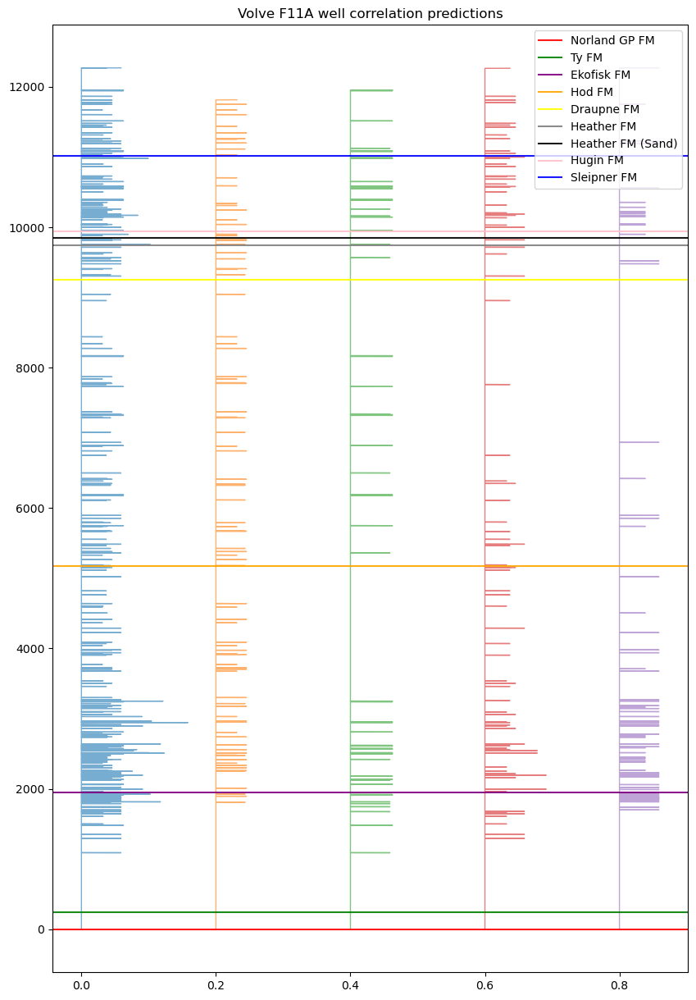

In [105]:
import matplotlib as mpl
#cmap = mpl.colormaps['']
plt.figure(figsize=(10,15))
plt.plot(np.sum(f11A_corrmatrix, axis=1), np.arange(len(f11A_corrmatrix)), linewidth=1, alpha=.6 )
plt.plot(np.sum(f11A_corrmatrixNPHI, axis=1)+0.2, np.arange(len(f11A_corrmatrixNPHI)), linewidth=1, alpha=.6 )
plt.plot(np.sum(f11A_corrmatrixRHOB, axis=1)+0.4, np.arange(len(f11A_corrmatrixRHOB)), linewidth=1, alpha=.6 )
plt.plot(np.sum(f11A_corrmatrixPEF, axis=1)+0.6, np.arange(len(f11A_corrmatrixPEF)), linewidth=1, alpha=.6 )
plt.plot(np.sum(f11A_corrmatrixGR, axis=1)+0.8, np.arange(len(f11A_corrmatrixGR)), linewidth=1, alpha=.6 )
maxx = len(data_f11A)
f11A_top10 = f11A_tops*10-26000 #25400
plt.title('Volve F11A well correlation predictions')
#f11A_top10
#cmap = plt.colormaps('turbo')
k=0
for i in f11A_top10:
    plt.axhline(i, alpha=0.9, color=f11A_color[k], label=f11A_FM[k])
    #print(k)
    k=k+1
plt.legend(loc='upper right')

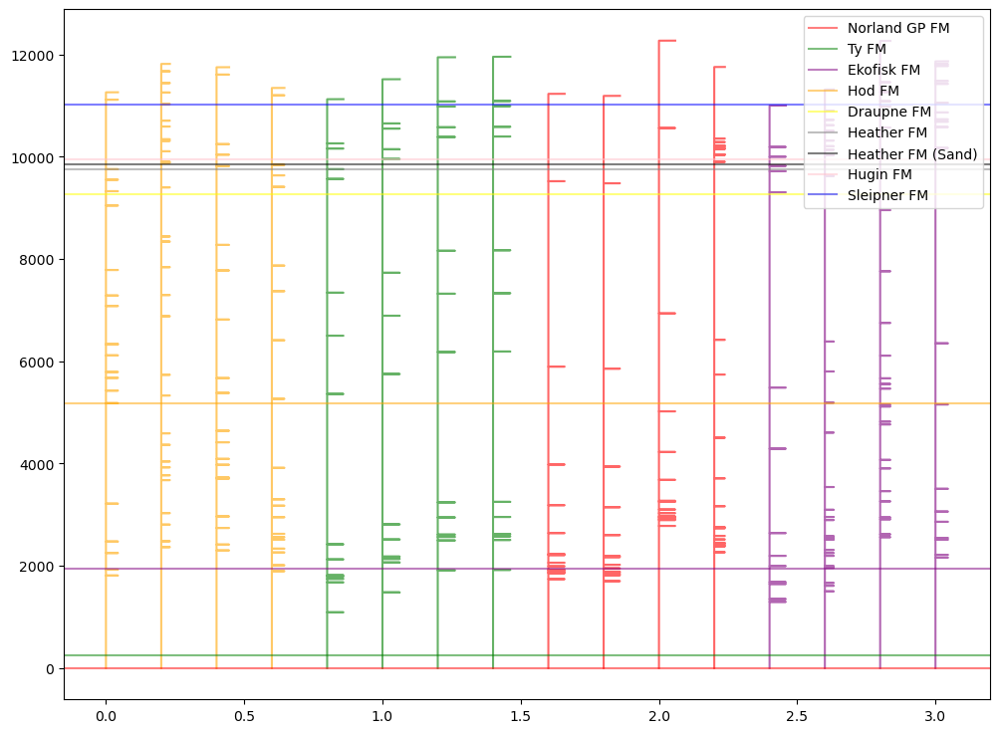

In [107]:
corrs = [f1A_11A_NPHIcorr, f1C_11A_NPHIcorr, f11B_11A_NPHIcorr , f1B_11A_NPHIcorr,
            f1B_11A_RHOBcorr,f1C_11A_RHOBcorr, f1A_11A_RHOBcorr, f11B_11A_RHOBcorr,
            f1B_11A_GRcorr,f1C_11A_GRcorr, f1A_11A_GRcorr, f11B_11A_GRcorr,
            f1B_11A_PEFcorr,f1C_11A_PEFcorr, f1A_11A_PEFcorr, f11B_11A_PEFcorr]
colory = {0:'orange', 1: 'orange', 2: 'orange', 3: 'orange', 4: 'green', 5: 'green', 6: 'green', 7: 'green', 8:'red',9:'red', 10:'red', 11: 'red', 12: 'purple', 13:'purple',14:'purple',15:'purple' }
plt.figure(figsize=(12,9))
for i in range(len(corrs)):
    plt.plot(corrs[i]+i*0.2, np.arange(len(corrs[i])), color=colory[i], alpha=0.6)
f11A_top10 = f11A_tops*10-26000
#f11A_top10
#cmap = plt.colormaps('turbo')
k=0
for i in f11A_top10:
    plt.axhline(i, alpha=0.5, color=f11A_color[k], label=f11A_FM[k])
    #print(k)
    k=k+1
plt.legend(loc='upper right')